# Project: Prediction of Sonic Log from Drilling Parameters and Wireline Logs Using Machine Learning Algorithms: A Case Study on Volve Field Wells

## Table of Contents
<ul>
<li><a href="#intro">Introduction</a></li>
<li><a href="#featureengineering">Feature engineering</a></li>
<li><a href="#eda">EDA</a></li>
<li><a href="#splitting">Data splitting</a></li>
<li><a href="#imputation">Missing value imputation</a></li>
<li><a href="#outlier">Outlier removing</a></li>
<li><a href="#scaling">Scaling</a></li>
<li><a href="#featureselection">Feature Selection</a></li>
<li><a href="#model">Model Traning</a></li>
<li><a href="#evaluation">Evaluation</a></li>
<li><a href="#tuning">Hyperparameter optimization</a></li>
<li><a href="#cr_valid">Cross-validation</a></li>
<li><a href="#conclusions">Conclusions</a></li>
</ul>

In [1]:
# Importing libaries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
#import lasio
import glob
import os

from dataprep.eda import plot, plot_correlation, create_report, plot_missing

from sklearn.model_selection import train_test_split, cross_val_score, KFold

from feature_engine.imputation import MeanMedianImputer

from feature_engine.outliers import OutlierTrimmer

from sklearn.preprocessing import StandardScaler, MinMaxScaler

from sklearn.feature_selection import f_regression, SelectKBest

from sklearn.ensemble         import GradientBoostingRegressor, RandomForestRegressor
from sklearn.linear_model     import LinearRegression, ElasticNet, Ridge, Lasso, BayesianRidge
from sklearn.neighbors        import KNeighborsRegressor
from sklearn.tree             import DecisionTreeRegressor
from sklearn.svm              import SVR
import xgboost                as xgb

from sklearn.metrics import mean_absolute_percentage_error, mean_absolute_error, mean_squared_error, r2_score

<a id='intro'></a>
## Introduction
> In the oil and gas industry, accurate prediction of subsurface properties is crucial for optimizing drilling operations and reservoir characterization. Sonic logs, such as the compressional wave slowness (DT), play a pivotal role in this process. However, acquiring complete well log data is often challenging, as certain logs may be missing or unavailable in some wells. This study focuses on addressing this challenge by employing supervised machine learning techniques to predict the DT log from available wireline logs and drilling parameters, utilizing data from the Volve field open database.

### Dataset Description 
> The training dataset comprised the three wells with complete DT logs, using NPHI, RHOB, GR, PEF, CALI logs, and drilling parameters (ROP, WOBAVG, FLOWIN, TORQUEAV, PUMPAVG) as features, while the missing DT logs in the other two wells served as the test data. Our study showcases the effectiveness of machine learning in filling gaps in well log data, ultimately enhancing the understanding of subsurface properties and aiding in the optimization of drilling operations.    Attribute information:
* `DEPTH:-` Depth of the well (meters)
* `WELL: -`  The name of the well
* `BS:   -` Bit size, typically in inches
* `GR:   -` Gamma ray measurements in API units or other relevant units
* `NPHI: -` Neutron porosity measurement
* `RHOB: -` Bulk density measurement, often in g/cm³
* `PEF:  -` Photoelectric factor measurement
* `CALI: -` Caliper log data, typically in inches or millimeters
* `ROP:  -` Rate of penetration, usually in feet or meters per hour
* `RT:   -`  Resistivity measurement, often in ohm-meters
* `DT:   -` Delta-T measurement, which can be in microseconds per foot or other units
* `WOBAVG:  -` Weighted average wellbore temperature in degrees Celsius or Fahrenheit
* `FLOWIN:  -` Flow rate into the well, often in barrels per minute (BPM) or other units
* `SURFRPM: -`Surface RPM (Revolutions Per Minute) of the drilling equipment
* `TORQUEAV:-` Average torque applied during drilling operations, usually in foot-pounds or Newton-meter
* `PUMPAVG: -` Average pump rate or pressure  (BAR)

### Load and Display the Well-log and Drilling parameters Datasets

In [2]:
# get all paths and alphabetically ordered
folder_path_log = r"C:\Users\Ramin\Desktop\PROJECT_SONIC (1)\PROJECT_SONIC\well_logs\CSV"
folder_path_drill = r"C:\Users\Ramin\Desktop\PROJECT_SONIC (1)\PROJECT_SONIC\wells_drilling"

# Get all CSV file paths and sort them alphabetically
paths_log = sorted(glob.glob(os.path.join(folder_path_log, "*.csv")))
paths_drill = sorted(glob.glob(os.path.join(folder_path_drill, "*.csv")))

# Initialize lists to store well log and drilling dataframes
well_logs = []
well_drills = []

# Loop through the files and process the data
for log_path, drill_path in zip(paths_log, paths_drill):
    # Logging part    
    log_df = pd.read_csv(log_path, index_col=0)
    # Reset the depth index to a column
    log_df = log_df.reset_index()
    
    well_name = os.path.splitext(os.path.basename(log_path))[0]
    log_df['WELL'] = well_name
    
    # Append the DataFrame to the well_logs list
    well_logs.append(log_df)
    
    # Drilling parameters part
    drill_df = pd.read_csv(drill_path, index_col=0)

    # Append the DataFrame to the well_drills list
    well_drills.append(drill_df)

# Unpack the individual DataFrames if needed
well1_log, well2_log, well3_log, well4_log, well5_log, well6_log = well_logs
well1_drill, well2_drill, well3_drill, well4_drill, well5_drill, well6_drill = well_drills

<a id='featureengineering'></a>
## Feature engineering

In [3]:
# Define column names for two different sets of columns
col_names_1345 = ['BS', 'GR', 'NPHI', 'RHOB', 'PEF', 'CALI', 'ROP', 'RT', 'DT', 'WELL', 'DEPTH']
col_names_26 = ['BS', 'GR', 'NPHI', 'RHOB', 'PEF', 'CALI', 'ROP', 'RT', 'WELL', 'DEPTH']

# Define the indices for which you want to use col_names_134
restrict_indices = [0,2,3,4]

# Create a list of DataFrames with restricted columns based on the indices
well_df_restrict = [well_logs[i][col_names_1345].copy() if i in restrict_indices else well_logs[i][col_names_26].copy() for i in range(6)]

# Unpack the individual DataFrames if needed
well1_log, well2_log, well3_log, well4_log, well5_log, well6_log = well_df_restrict

In [4]:
# Create a list of well DataFrames
well_list = [well1_log, well2_log, well3_log, well4_log, well5_log, well6_log]

# Iterate through each well DataFrame in the list
for well in well_list:
    # Drop rows with missing values in the specified columns: 'NPHI', 'RHOB', 'PEF', 'CALI'
    well.dropna(subset=['NPHI', 'RHOB', 'PEF', 'CALI'], inplace=True)

In [5]:
"""def d_exponent_func(x):
    try:
        if x["ROP"] <= 0 or x["SURFRPM"] <= 0 or x["WOBAVG"] <= 0 or x["BS"] <= 0:
            return np.nan

        numerator = np.log(x["ROP"] / (60 * x["SURFRPM"]))
        denominator = np.log((12 * x["WOBAVG"]) / ((10**6) * x["BS"]))
        
        result = numerator / denominator
        return round(result, 3)
    except ZeroDivisionError:
        return np.nan"""

'def d_exponent_func(x):\n    try:\n        if x["ROP"] <= 0 or x["SURFRPM"] <= 0 or x["WOBAVG"] <= 0 or x["BS"] <= 0:\n            return np.nan\n\n        numerator = np.log(x["ROP"] / (60 * x["SURFRPM"]))\n        denominator = np.log((12 * x["WOBAVG"]) / ((10**6) * x["BS"]))\n        \n        result = numerator / denominator\n        return round(result, 3)\n    except ZeroDivisionError:\n        return np.nan'

In [6]:
# Concatenate well1_drill and well1_log DataFrames, sort by 'DEPTH', and reset the index
# Drop the 'DEPT' column from the resulting DataFrame and assign it to well_1_main
well_1_main = pd.concat([well1_drill, (well1_log.sort_values(by='DEPTH')).reset_index(drop=True)], axis=1).drop("DEPT", axis=1)

# Repeat the same process for well2_main, well3_main, well4_main, and well5_main
well_2_main = pd.concat([well2_drill, (well2_log.sort_values(by='DEPTH')).reset_index(drop=True)], axis=1).drop("DEPT", axis=1)
well_3_main = pd.concat([well3_drill, (well3_log.sort_values(by='DEPTH')).reset_index(drop=True)], axis=1).drop("DEPT", axis=1)
well_4_main = pd.concat([well4_drill, (well4_log.sort_values(by='DEPTH')).reset_index(drop=True)], axis=1).drop("DEPT", axis=1)
well_5_main = pd.concat([well5_drill, (well5_log.sort_values(by='DEPTH')).reset_index(drop=True)], axis=1).drop("DEPT", axis=1)
well_6_main = pd.concat([well6_drill, (well6_log.sort_values(by='DEPTH')).reset_index(drop=True)], axis=1).drop("DEPT", axis=1)

# Drop rows with NaN values from well_2_main and well_5_main
#well_2_main.dropna(inplace=True)
#well_6_main.dropna(inplace=True)

In [7]:
"""well_1_main['D_EXP'] = well_1_main.apply(d_exponent_func, axis=1)
well_2_main['D_EXP'] = well_2_main.apply(d_exponent_func, axis=1)
well_3_main['D_EXP'] = well_3_main.apply(d_exponent_func, axis=1)
well_4_main['D_EXP'] = well_4_main.apply(d_exponent_func, axis=1)
well_5_main['D_EXP'] = well_5_main.apply(d_exponent_func, axis=1)
well_6_main['D_EXP'] = well_6_main.apply(d_exponent_func, axis=1)"""

"well_1_main['D_EXP'] = well_1_main.apply(d_exponent_func, axis=1)\nwell_2_main['D_EXP'] = well_2_main.apply(d_exponent_func, axis=1)\nwell_3_main['D_EXP'] = well_3_main.apply(d_exponent_func, axis=1)\nwell_4_main['D_EXP'] = well_4_main.apply(d_exponent_func, axis=1)\nwell_5_main['D_EXP'] = well_5_main.apply(d_exponent_func, axis=1)\nwell_6_main['D_EXP'] = well_6_main.apply(d_exponent_func, axis=1)"

In [8]:
def plot_well_logs(well_data,dataset_form='train'):
    
    log_names = ['NPHI', 'RHOB', 'GR', 'RT', 'PEF', 'CALI', 'DT']
    # Defining colors for each log parameter
    colors = ['black', 'red', 'blue', 'green', 'purple', 'orange', 'brown']
    
    if dataset_form == 'predicted':
        colors = ['purple', 'purple', 'purple', 'purple', 'purple', 'purple', 'green']
    elif dataset_form != 'train':        
        log_names = log_names[:-1]
        colors = colors[:-1]
    
    # Create the subplots; ncols equals the number of logs
    fig, ax = plt.subplots(nrows=1, ncols=len(log_names), figsize=(12, 6), dpi=200)

    for i, log in enumerate(log_names):
        if i == 3:
            # For resistivity, semilog plot
            ax[i].semilogx(well_data[log], well_data['DEPTH'], color=colors[i], label=log)
        else:
            # For non-resistivity, normal plot
            ax[i].plot(well_data[log], well_data['DEPTH'], color=colors[i], label=log)

        ax[i].set_title(log)
        ax[i].set_xlabel(log)  # Add X-axis label
        ax[i].grid(True)
        ax[i].invert_yaxis()  # Invert Y-axis for depth

    fig.subplots_adjust(hspace=0.4, top=0.85)
    plt.suptitle(f"{well_data['WELL'].unique()[0]} Well Log Data", fontsize=15)

    ax[2].set_xlim(0, 300)

    # Adjusting layout
    plt.tight_layout()
    
    # Display the plot
    plt.show()

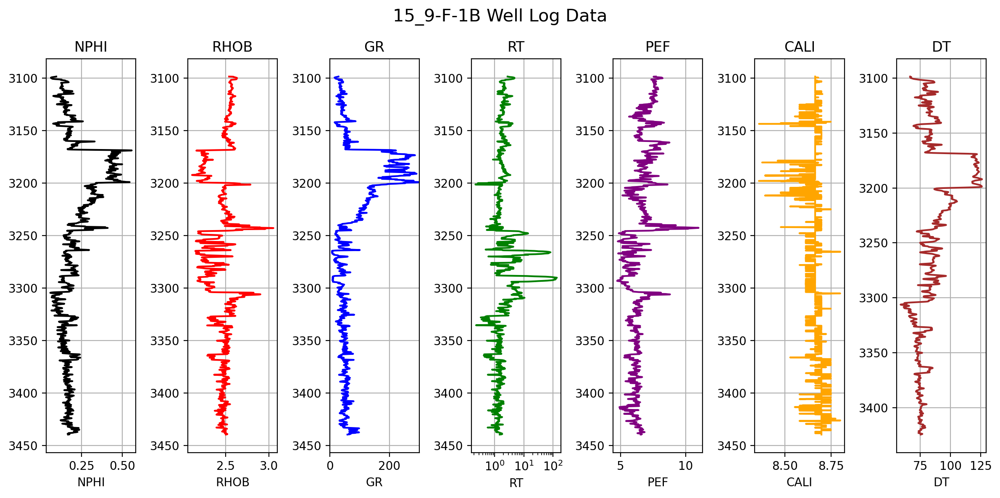

In [9]:
# Call the plot_well_logs function with the 'well_2_main' dataset and 'test' dataset_form
plot_well_logs(well_5_main, 'train')

Modelin qurulması üçün:

15_9-F-11_T2 19593  index[2], well_num = 3

15_9-F-11A   11597  index[0], well_num = 1

15_9-F-1B    3413   index[4], well_num = 5
***
Son modeli test edib heç istifadə olunmayan quyu ilə yoxlamaq üçün:

15_9-F-1A    10524  index[3], well_num = 4
***
Modeldən istifadə edərək müxtəlif quyularda DT tapmaq üçün:

15_9-F-11B   15466  index[1], well_num = 2

15_9-F-1C    10103  index[5], well_num = 6

In [10]:
# Merge data from well_1_main, well_3_main, and well_5_main into a single DataFrame
well_modelling = pd.concat([well_1_main, well_3_main,well_5_main], ignore_index=True)

# Merge data from well_2_main and well_5_main into another single DataFrame
#well_2_6_pred = pd.concat([well_2_main, well_6_main], ignore_index=True)

<a id='eda'></a>
## EDA

In [11]:
well_modelling.describe()

,WOBAVG,FLOWIN,SURFRPM,TORQUEAV,PUMPAVG,BS,GR,NPHI,RHOB,PEF,CALI,ROP,RT,DT,DEPTH
count,34603.000000,34603.000000,34603.000000,34603.000000,34603.000000,34603.0,34582.000000,34603.000000,34603.000000,34603.000000,34603.000000,34603.000000,34603.000000,34180.000000,34603.000000
mean,8.952200,3858.506666,-150.323824,3.093341,135.252247,8.5,36.997437,0.162516,2.482230,7.453033,8.666592,22.016564,39.787581,77.076390,3394.252282
std,6.072577,681.531202,366.111960,2.885187,40.504907,0.0,50.140491,0.099186,0.138725,1.169512,0.056220,7.867119,1396.008279,15.292897,505.003807
min,0.100000,2571.682000,-999.250000,-0.037500,59.142800,8.5,0.838000,-0.003000,2.033000,4.729900,8.360400,0.341000,0.071000,48.928000,2577.000000
25%,3.382200,2990.250000,0.000000,1.405910,89.137420,8.5,8.947000,0.089000,2.438000,6.629500,8.625000,14.994000,1.701600,66.354000,3009.500000
50%,8.655360,4425.294440,0.039060,2.090000,157.818600,8.5,19.052000,0.136000,2.523000,7.859000,8.672000,20.218000,2.828000,71.791600,3327.500000
75%,13.092900,4496.449700,1.651600,3.712700,173.129200,8.5,44.066025,0.215000,2.580000,8.371000,8.703000,27.005500,5.192500,85.816750,3703.900000
max,30.121600,4520.284800,62.422400,17.925200,194.640700,8.5,1124.403000,0.559000,3.051700,13.841000,8.992000,49.999000,62290.770000,136.253000,4536.200000


  0%|                                                                                         | 0/1105 [00:00<…


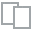
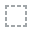
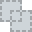
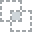
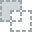
...
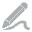
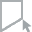
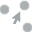
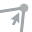
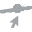

In [12]:
plot(well_modelling)


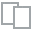
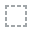
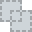
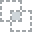
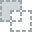
...
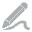
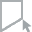
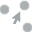
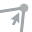
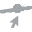

In [13]:
plot_correlation(well_modelling)

  0%|                                                                                          | 0/341 [00:00<…

C:\Users\Ramin\anaconda3\lib\site-packages\numpy\lib\function_base.py:2853: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\Ramin\anaconda3\lib\site-packages\numpy\lib\function_base.py:2854: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]



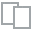
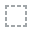
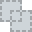
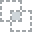
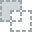
...
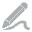
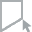
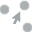
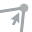
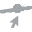

In [14]:
plot_correlation(well_modelling, 'DT')

  0%|                                                                                         | 0/3062 [00:00<…

C:\Users\Ramin\anaconda3\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


DataPrep Report
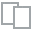
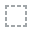
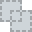
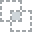
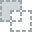
...
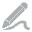
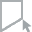
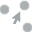
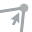
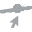

In [15]:
create_report(well_modelling)

In [16]:
well_modelling.corr(numeric_only=True)['DT']

WOBAVG     -0.199042
FLOWIN      0.358004
SURFRPM    -0.039049
TORQUEAV   -0.057905
PUMPAVG     0.306403
BS               NaN
GR          0.700702
NPHI        0.948987
RHOB       -0.787687
PEF        -0.602408
CALI       -0.291471
ROP         0.231767
RT          0.006386
DT          1.000000
DEPTH      -0.055035
Name: DT, dtype: float64

<a id='splitting'></a>
## Data splitting

In [17]:
well_modelling.shape

(34603, 16)

In [18]:
# Remove the column named 'BS' from the 'well_modelling' DataFrame.
#well_modelling.drop(['BS'],axis=1,inplace=True)

In [19]:
well_modelling.columns

Index(['WOBAVG', 'FLOWIN', 'SURFRPM', 'TORQUEAV', 'PUMPAVG', 'BS', 'GR',
       'NPHI', 'RHOB', 'PEF', 'CALI', 'ROP', 'RT', 'DT', 'WELL', 'DEPTH'],
      dtype='object')

In [20]:
well_modelling.dropna(subset=['DT'], inplace=True)

In [21]:
"""well_modelling.dropna(subset=['D_EXP'], inplace=True)"""

"well_modelling.dropna(subset=['D_EXP'], inplace=True)"

In [22]:
well_modelling.shape

(34180, 16)

In [23]:
# Create a new DataFrame 'X' by excluding the 'DT' column from 'well_modelling'.
X = well_modelling.drop('DT', axis=1)

# Create a Series 'y' containing the 'DT' column data from 'well_modelling'.
y = well_modelling['DT']

In [24]:
# 70% train, 30% test
train_ratio = 0.70
test_ratio = 0.30

# Split the data into training, validation, and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=1 - train_ratio, random_state=27)

<a id='imputation'></a>
## Missing value imputation

In [25]:
well_modelling.isnull().sum()

WOBAVG       0
FLOWIN       0
SURFRPM      0
TORQUEAV     0
PUMPAVG      0
BS           0
GR          21
NPHI         0
RHOB         0
PEF          0
CALI         0
ROP          0
RT           0
DT           0
WELL         0
DEPTH        0
dtype: int64

In [26]:
median_imputer = MeanMedianImputer(imputation_method='median',variables = ['ROP','GR'])
#,'D_EXP'

In [27]:
# impute the data
X_train = median_imputer.fit_transform(X_train)
X_test = median_imputer.transform(X_test)

In [28]:
well_modelling[15000:15010]

,WOBAVG,FLOWIN,SURFRPM,TORQUEAV,PUMPAVG,BS,GR,NPHI,RHOB,PEF,CALI,ROP,RT,DT,WELL,DEPTH
15133,16.0495,3499.7,29.9276,12.0461,115.5470,8.5,3.935,0.089,2.568,8.896,8.625,29.751,4.167,66.271,15_9-F-11_T2,2930.6
15134,16.0495,3499.7,29.9276,12.0461,115.5470,8.5,4.167,0.089,2.566,8.886,8.625,30.233,4.153,66.094,15_9-F-11_T2,2930.7
15135,16.3808,3499.7,29.9277,12.5463,116.2862,8.5,4.180,0.089,2.563,8.897,8.625,28.134,4.172,65.846,15_9-F-11_T2,2930.8
15136,16.3808,3499.7,29.9277,12.5463,116.2862,8.5,3.729,0.090,2.561,8.913,8.625,26.035,4.188,65.452,15_9-F-11_T2,2930.9
15137,16.3808,3499.7,29.9277,12.5463,116.2862,8.5,3.127,0.091,2.558,8.931,8.625,23.937,4.207,65.043,15_9-F-11_T2,2931.0
15138,16.3808,3499.7,29.9277,12.5463,116.2862,8.5,2.569,0.091,2.555,8.959,8.625,22.427,4.269,64.625,15_9-F-11_T2,2931.1
15139,16.3808,3499.7,29.9277,12.5463,116.2862,8.5,2.714,0.091,2.553,9.001,8.625,20.917,4.363,64.209,15_9-F-11_T2,2931.2
15140,15.9506,3499.7,29.9277,12.1172,115.7927,8.5,3.160,0.090,2.552,9.036,8.625,19.408,4.383,63.878,15_9-F-11_T2,2931.3
15141,15.9506,3499.7,29.9277,12.1172,115.7927,8.5,2.805,0.089,2.555,9.062,8.625,18.721,4.404,63.686,15_9-F-11_T2,2931.4
15142,15.9506,3499.7,29.9277,12.1172,115.7927,8.5,2.609,0.083,2.558,9.083,8.648,18.033,4.487,63.594,15_9-F-11_T2,2931.5


<a id='outlier'></a>
## Outlier removing

In [29]:
well_modelling.describe()

,WOBAVG,FLOWIN,SURFRPM,TORQUEAV,PUMPAVG,BS,GR,NPHI,RHOB,PEF,CALI,ROP,RT,DT,DEPTH
count,34180.000000,34180.000000,34180.000000,34180.000000,34180.000000,34180.0,34159.000000,34180.000000,34180.000000,34180.000000,34180.000000,34180.000000,34180.000000,34180.000000,34180.000000
mean,9.001933,3857.845805,-148.539618,3.067996,134.965477,8.5,36.672851,0.162392,2.482064,7.463851,8.665960,22.035206,40.260228,77.076390,3388.162282
std,6.065281,684.364448,364.156137,2.867071,40.507638,0.0,50.340428,0.099735,0.139357,1.171392,0.056087,7.879981,1404.613721,15.292897,502.457315
min,0.100000,2571.682000,-999.250000,-0.037500,59.142800,8.5,0.838000,-0.003000,2.033000,4.729900,8.360400,0.341000,0.071000,48.928000,2577.000000
25%,3.461300,2990.250000,0.000000,1.401305,89.055600,8.5,8.882000,0.088000,2.436075,6.656000,8.625000,15.003450,1.736000,66.354000,3004.200000
50%,8.690300,4429.936100,0.045180,2.085710,157.663100,8.5,18.483000,0.135000,2.523000,7.878000,8.672000,20.286750,2.871500,71.791600,3320.450000
75%,13.145700,4496.449700,1.651600,3.688900,173.029800,8.5,42.818200,0.216000,2.580000,8.375000,8.703000,26.969325,5.225250,85.816750,3695.600000
max,30.121600,4520.284800,62.422400,17.925200,194.640700,8.5,1124.403000,0.559000,3.051700,13.841000,8.992000,49.999000,62290.770000,136.253000,4522.300000


In [30]:
well_modelling.columns

Index(['WOBAVG', 'FLOWIN', 'SURFRPM', 'TORQUEAV', 'PUMPAVG', 'BS', 'GR',
       'NPHI', 'RHOB', 'PEF', 'CALI', 'ROP', 'RT', 'DT', 'WELL', 'DEPTH'],
      dtype='object')

In [31]:
outlier_cols = ['WOBAVG','FLOWIN','TORQUEAV','SURFRPM','PUMPAVG','GR','ROP','DEPTH','NPHI','RHOB', 'PEF', 'CALI','RT']
# ,'D_EXP'

# 'WOBAVG','FLOWIN','TORQUEAV','SURFRPM','PUMPAVG','GR','ROP','DEPTH','NPHI','RHOB', 'PEF', 'CALI','RT'

In [32]:
# trimming at both tails using iqr capping method
trimmer = OutlierTrimmer(
    capping_method='iqr', tail='both', variables=outlier_cols)


"""trimmer = OutlierTrimmer(
    capping_method='gaussian', tail='both', fold=3, variables=outlier_cols)"""


trimmer.fit(X_train)

OutlierTrimmer(capping_method='iqr', tail='both',
               variables=['WOBAVG', 'FLOWIN', 'TORQUEAV', 'SURFRPM', 'PUMPAVG',
                          'GR', 'ROP', 'DEPTH', 'NPHI', 'RHOB', 'PEF', 'CALI',
                          'RT'])

In [33]:
# transforming the training and testing data
train_t = trimmer.transform(X_train)
test_t = trimmer.transform(X_test)

# Print information about the training data after removing outliers
print("train data shape after removing outliers:", train_t.shape)
print(f"{X_train.shape[0] - train_t.shape[0]} observations are removed\n")

# Print information about the testing data after removing outliers
print("test data shape after removing outliers:", test_t.shape)
print(f"{X_test.shape[0] - test_t.shape[0]} observations are removed\n")



train data shape after removing outliers: (14873, 15)
9052 observations are removed

test data shape after removing outliers: (6497, 15)
3758 observations are removed



In [34]:
# Transform the original training data using the Trimmer and overwrite the variable
X_train = trimmer.transform(X_train)
X_test = trimmer.transform(X_test)

In [35]:
# Filter the y_train, y_test and y_val data to keep only the rows (indices) that exist in X_train, X_test and X_val
y_train = y_train[y_train.index.isin(X_train.index)]
y_test = y_test[y_test.index.isin(X_test.index)]

In [36]:
# Print the dimensions of the training data for the input features and target values
print("X_train: ",X_train.shape)
print("y_train: ",y_train.shape,'\n')

# Print the dimensions of the testing data for the input features and target values
print("X_test: ",X_test.shape)
print("y_test: ",y_test.shape,'\n')

X_train:  (14873, 15)
y_train:  (14873,) 

X_test:  (6497, 15)
y_test:  (6497,) 



Separate Depth and Well columns from the Train Test and Validation sets

In [37]:
# Create a new DataFrame 'depth_well_train' containing only the 'DEPTH' and 'WELL' columns from the training data 'X_train'.
depth_well_train = X_train[['DEPTH', 'WELL']]

# Create a new DataFrame 'depth_well_test' containing only the 'DEPTH' and 'WELL' columns from the testing data 'X_test'.
depth_well_test = X_test[['DEPTH', 'WELL']]

# Remove (drop) the 'DEPTH' and 'WELL' columns from the training data 'X_train' along the columns axis (axis=1).
X_train.drop(['DEPTH', 'WELL'], axis=1, inplace=True)

# Remove (drop) the 'DEPTH' and 'WELL' columns from the testing data 'X_test' along the columns axis (axis=1).
X_test.drop(['DEPTH', 'WELL'], axis=1, inplace=True)

<a id='scaling'></a>
## Scaling

In [38]:
feature_names = X_train.columns

In [39]:
len(feature_names)

13

In [40]:
X_train = X_train[np.isfinite(X_train).all(1)]
X_test = X_test[np.isfinite(X_test).all(1)]

In [41]:
y_train = y_train[y_train.index.isin(X_train.index)]
y_test = y_test[y_test.index.isin(X_test.index)]

In [42]:
scaler = StandardScaler()

In [43]:
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

<a id='featureselection'></a>
## Feature Selection

In [44]:
y_train.isnull().sum()

0

In [45]:
# Create a SelectKBest instance with the scoring function of your choice
k_best = SelectKBest(score_func=f_regression, k=9)  # In this example, we're using f_classif

# Fit the SelectKBest instance to the training data and transform both training and testing data
X_train_selected = k_best.fit_transform(X_train, y_train)
X_test_selected = k_best.transform(X_test)

# Get the indices of the selected features
selected_indices = k_best.get_support(indices=True)

# Print the selected features

selected_feature_names = [feature_names[i] for i in selected_indices]

print("Selected Feature Names:",selected_feature_names)

Selected Feature Names: ['FLOWIN', 'PUMPAVG', 'GR', 'NPHI', 'RHOB', 'PEF', 'CALI', 'ROP', 'RT']


<a id='model'></a>
## Model Traning

In [46]:
# Step 2: Select Algorithms
# Define the algorithms you want to test
algorithms = {'RandomForestRegressor' : RandomForestRegressor(n_estimators=100, max_depth=5, random_state=43),
              'DecisionTreeRegressor' : DecisionTreeRegressor(max_depth=4),
              'ElasticNet' : ElasticNet(alpha=1, l1_ratio=0.5),
              'Support Vector Machine' : SVR(),
              'BayesianRidge' : BayesianRidge(),
              'Ridge' : Ridge(alpha=1),
              'Lasso' : Lasso(alpha=1)}

# ,'XGBOOST' : xgb.XGBRegressor(), 'LinearRegression' : LinearRegression()
# 'KNeighborsRegressor' : KNeighborsRegressor(), 'GradientBoostingRegressor' : GradientBoostingRegressor()

# Create a DataFrame to store results
results_df = pd.DataFrame(columns=['Algorithm', 'Accuracy'])

# Step 3 and 4: Train and Evaluate Models
for algo_name, algorithm in algorithms.items():
    # Train the model
    algorithm.fit(X_train_selected, y_train)
    
    # Make predictions on the test data
    y_pred = algorithm.predict(X_test_selected)
    
    # Evaluate the model
    accuracy = r2_score(y_test, y_pred)
    
    # Store the results in the DataFrame
    temp_df = pd.DataFrame({'Algorithm': [algo_name], 'Accuracy': [accuracy]})

    results_df = pd.concat([results_df, temp_df], ignore_index=True)

In [47]:
results_df.sort_values(by='Accuracy')

,Algorithm,Accuracy
2,ElasticNet,0.857316
6,Lasso,0.892808
1,DecisionTreeRegressor,0.907337
5,Ridge,0.907358
4,BayesianRidge,0.907358
0,RandomForestRegressor,0.933945
3,Support Vector Machine,0.951342


In [49]:
#, palette="viridis"

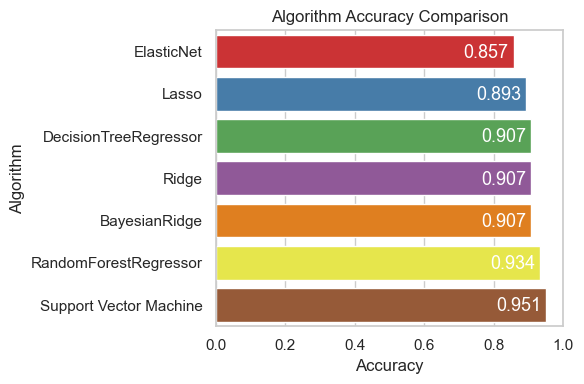

In [50]:
# Create a bar plot using Seaborn
plt.figure(figsize=(6, 4), dpi=100)
sns.set(style="whitegrid")
ax = sns.barplot(x="Accuracy", y="Algorithm", data=results_df.sort_values(by='Accuracy'), palette="Set1")
plt.xlabel('Accuracy')
plt.ylabel('Algorithm')
plt.title('Algorithm Accuracy Comparison')
plt.xlim(0, 1)
# Add accuracy values as text labels on the bars
for p in ax.patches:
    ax.annotate(f'{p.get_width():.3f}', (p.get_width() - 0.08, p.get_y() + p.get_height() / 2 +0.15), 
                ha='center',color='white',fontsize=13)

plt.tight_layout()
plt.show()

In [51]:
#model = SVR()
model = DecisionTreeRegressor(max_depth=4)
model.fit(X_train_selected, y_train)

DecisionTreeRegressor(max_depth=4)

In [52]:
y_pred = model.predict(X_test_selected)

<a id='evaluation'></a>
## Model Evaluation

In [53]:
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
mape = mean_absolute_percentage_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

# Create a DataFrame
data = {'Metric': ['Mean Absolute Error', 'Mean Squared Error', 'Mean Absolute Percentage Error', 'R-squared'],
        'Value': [mae, mse, mape, r2]}
df = pd.DataFrame(data)

df

,Metric,Value
0,Mean Absolute Error,2.498247
1,Mean Squared Error,13.590204
2,Mean Absolute Percentage Error,0.032412
3,R-squared,0.907337


<a id='tuning'></a>
## Hyperparameter optimization

In [77]:
"""# Define the SVR model
svr = SVR()

# Define a parameter grid for grid search
param_grid = {
    'C': [0.1, 1, 10],
    'kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
    'epsilon': [0.01, 0.1, 0.2],
    'gamma': ['scale', 'auto'] + [0.001, 0.01, 0.1, 1, 10]}

# Create a grid search object
grid_search = GridSearchCV(svr, param_grid, scoring='neg_mean_squared_error', cv=5)

# Fit the grid search to the training data
grid_search.fit(X_train_selected, y_train)

# Get the best parameters from the grid search
best_params = grid_search.best_params_

# Train an SVR model with the best parameters
best_svr = SVR(**best_params)
best_svr.fit(X_train_selected, y_train)

# Make predictions on the test set
y_pred = best_svr.predict(X_test_selected)

mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)
print("Best SVR Parameters:", best_params)
print("Root Mean Squared Error (RMSE) on Test Data:", rmse)
print("R2 on Test Data:", r2)"""

'# Define the SVR model\nsvr = SVR()\n\n# Define a parameter grid for grid search\nparam_grid = {\n    \'C\': [0.1, 1, 10],\n    \'kernel\': [\'linear\', \'poly\', \'rbf\', \'sigmoid\'],\n    \'epsilon\': [0.01, 0.1, 0.2],\n    \'gamma\': [\'scale\', \'auto\'] + [0.001, 0.01, 0.1, 1, 10]}\n\n# Create a grid search object\ngrid_search = GridSearchCV(svr, param_grid, scoring=\'neg_mean_squared_error\', cv=5)\n\n# Fit the grid search to the training data\ngrid_search.fit(X_train_selected, y_train)\n\n# Get the best parameters from the grid search\nbest_params = grid_search.best_params_\n\n# Train an SVR model with the best parameters\nbest_svr = SVR(**best_params)\nbest_svr.fit(X_train_selected, y_train)\n\n# Make predictions on the test set\ny_pred = best_svr.predict(X_test_selected)\n\nmse = mean_squared_error(y_test, y_pred)\nrmse = np.sqrt(mse)\nr2 = r2_score(y_test, y_pred)\nprint("Best SVR Parameters:", best_params)\nprint("Root Mean Squared Error (RMSE) on Test Data:", rmse)\nprint

In [78]:
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVR
import numpy as np

# Define the hyperparameter grid
param_grid = {
    'kernel': ['linear', 'rbf'],  # Try different kernels
    'C': [0.1, 1, 10],            # Regularization parameter C
    'gamma': [0.01, 0.1, 1],}      # Kernel-specific parameter for 'rbf' kernel}

# Create the SVR model
svr = SVR()

# Perform grid search with cross-validation
grid_search = GridSearchCV(estimator=svr, param_grid=param_grid, scoring='neg_mean_squared_error', cv=5)
grid_search.fit(X_train_selected, y_train)

# Get the best hyperparameters and the corresponding model
best_params = grid_search.best_params_
best_svr_model = grid_search.best_estimator_

# Evaluate the best model on the test data
y_pred = best_svr_model.predict(X_test_selected)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)
print("Best SVR Parameters:", best_params)
print("Root Mean Squared Error (RMSE) on Test Data:", rmse)
print("R2 on Test Data:", r2)

Best SVR Parameters: {'C': 10, 'gamma': 1, 'kernel': 'rbf'}
Root Mean Squared Error (RMSE) on Test Data: 1.9571906959525345
R2 on Test Data: 0.9738816730513357


In [56]:
"""import numpy as np
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.metrics import mean_squared_error

# Create the decision tree regression model
tree_regressor = DecisionTreeRegressor()

# Define a grid of hyperparameters to search
param_grid = {
    'max_depth': [2, 4, 6, 8, 10],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

# Perform a grid search with cross-validation to find the best hyperparameters
grid_search = GridSearchCV(tree_regressor, param_grid, cv=5, scoring='neg_mean_squared_error')
grid_search.fit(X_train_selected, y_train)

# Get the best hyperparameters from the grid search
best_params = grid_search.best_params_
best_tree_regressor = grid_search.best_estimator_

# Make predictions on the test set
y_pred = best_tree_regressor.predict(X_test_selected)

# Calculate the Mean Squared Error (MSE) on the test set
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)
print("Best SVR Parameters:", best_params)
print("Root Mean Squared Error (RMSE) on Test Data:", rmse)
print("R2 on Test Data:", r2)"""

Best SVR Parameters: {'max_depth': 10, 'min_samples_leaf': 2, 'min_samples_split': 5}
Root Mean Squared Error (RMSE) on Test Data: 2.4839578885554148
R2 on Test Data: 0.9579304829348265


<a id='cr_valid'></a>
## Cross-validation with Well 4

In [87]:
well_4_main.dropna(subset=['DT'], inplace=True)

well_4_main_depth_well = well_4_main[['DEPTH','WELL']]

y_validation_4 = well_4_main['DT']

X_validation_4 = well_4_main[selected_feature_names]

X_validation_4.isnull().sum()
X_validation_4 = X_validation_4.fillna(X_validation_4.median())

In [88]:
X_validation_4 = scaler.fit_transform(X_validation_4)

In [89]:
# Step 2: Cross-validation with the best model
num_folds = 5  # Define the number of folds for cross-validation

kf = KFold(n_splits=num_folds, shuffle=True, random_state=42)

# Perform cross-validation and compute the R2 scores (you can use other regression metrics)
cross_val_scores = cross_val_score(best_svr_model, X_validation_4, y_validation_4, cv=kf, scoring='r2')

# Print the cross-validation scores and their mean to assess the model's performance
print("Cross-Validation Scores:", cross_val_scores)
print("Mean R2 Score:", np.mean(cross_val_scores))

Cross-Validation Scores: [0.97518645 0.96820214 0.97757117 0.97582853 0.97702133]
Mean R2 Score: 0.9747619246078546


In [90]:
y_pred4 = best_svr_model.predict(X_validation_4)

In [91]:
y_pred4.shape

(10224,)

In [92]:
well_4_main_depth_well.loc[:, 'True_DT'] = y_validation_4
well_4_main_depth_well.loc[:, 'Pred_DT'] = y_pred4

C:\Users\Ramin\AppData\Local\Temp\ipykernel_12748\2267345635.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_4_main_depth_well.loc[:, 'True_DT'] = y_validation_4
C:\Users\Ramin\AppData\Local\Temp\ipykernel_12748\2267345635.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_4_main_depth_well.loc[:, 'Pred_DT'] = y_pred4


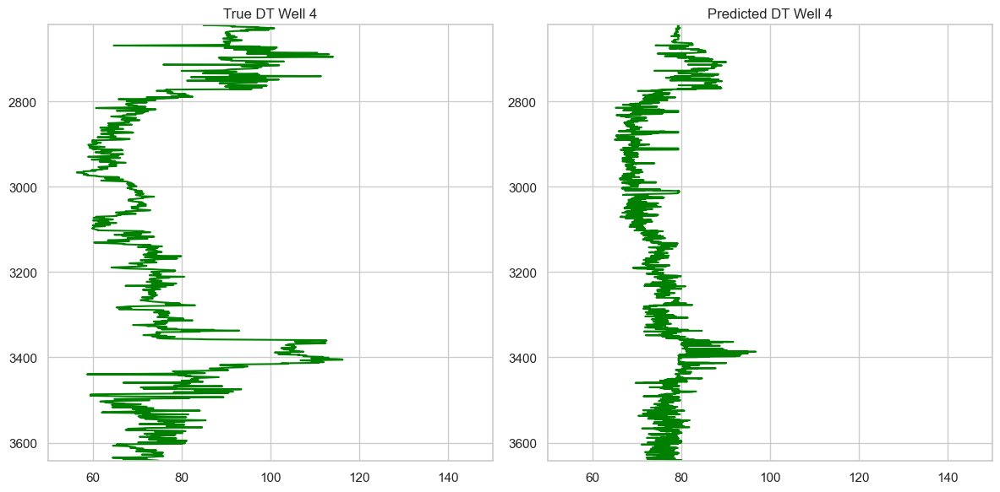

In [93]:
x = [y_validation_4,y_pred4]
y = [well_4_main['DEPTH'],well_4_main['DEPTH']]


color = ['green', 'green',]
title = ['True DT Well 4', 'Predicted DT Well 4']

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(12,6))

for i in range(len(x)):
    ax[i].plot(x[i], y[i], color=color[i])
    ax[i].set_xlim(50, 150)
    ax[i].set_ylim(np.max(y[i]), np.min(y[i]))
    ax[i].set_title(title[i])

plt.tight_layout()
plt.show()

In [95]:
well_4_main_depth_well.set_index('DEPTH', inplace=True)

KeyError: "None of ['DEPTH'] are in the columns"

In [96]:
def plot_result(true, prediction, scale):
    fig,ax = plt.subplots(figsize=(10, 15))

    ax.plot(true.iloc[::scale*2].sort_index(), true.iloc[::scale*2].sort_index().index, color="blue")
    ax.set_xlabel("DT", fontsize = 10)
    ax.set_ylabel("DEPTH", fontsize=10)

    ax.plot(prediction[::scale*2], prediction.iloc[::scale*2].index, color="red")
    ax.set_xlabel("DT", fontsize = 10)
    ax.set_ylabel("DEPTH", fontsize=10)
    
    ax.legend(['original', 'prediction'])
    
    ax.invert_yaxis()

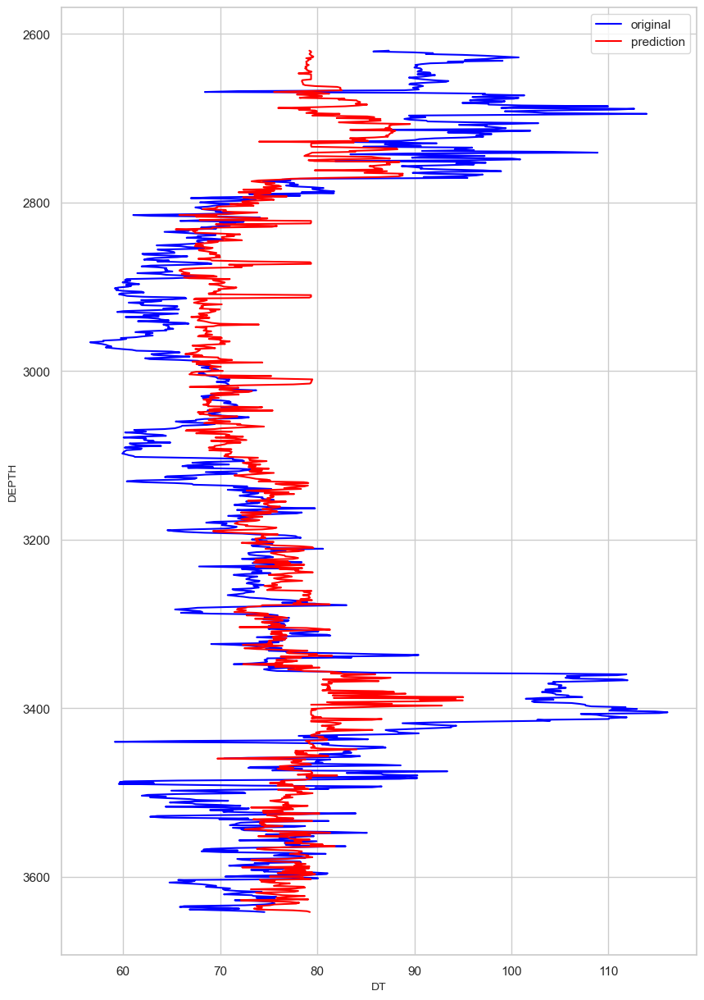

In [97]:
prediction = well_4_main_depth_well['Pred_DT']
true = well_4_main_depth_well['True_DT']

plot_result(true,prediction, scale=5)  # scale shows meters

### Comparing predicted DT with actual DT for wells 1,3,5

In [98]:
depth_well_test['Predicted_DT'] = best_svr_model.predict(X_test_selected)
depth_well_test['True DT'] = y_test

In [99]:
depth_well_test['WELL'].unique()

array(['15_9-F-11A', '15_9-F-11_T2', '15_9-F-1B'], dtype=object)

In [100]:
well_1 = (depth_well_test[depth_well_test['WELL']=='15_9-F-11A']).sort_values(by='DEPTH')
well_3 = (depth_well_test[depth_well_test['WELL']=='15_9-F-11_T2']).sort_values(by='DEPTH')
well_5 = (depth_well_test[depth_well_test['WELL']=='15_9-F-1B']).sort_values(by='DEPTH')

well_1.set_index('DEPTH', inplace=True)
well_3.set_index('DEPTH', inplace=True)
well_5.set_index('DEPTH', inplace=True)

In [101]:
"""x = [well_1['True DT'],well_1['Predicted_DT'],
     well_3['True DT'],well_3['Predicted_DT']]
# well_5['True DT'],well_5['Predicted_DT']
#, well_5['DEPTH'], well_5['DEPTH']
#'True DT Well 4', 'Predicted DT Well 4'
#, 'purple', 'green'
y = [well_1['DEPTH'], well_1['DEPTH'], well_3['DEPTH'], well_3['DEPTH']]

color = ['purple', 'green', 'purple', 'green']
title = ['True DT Well 1', 'Predicted DT Well 1', 'True DT Well 3', 'Predicted DT Well 3']

fig, ax = plt.subplots(nrows=1, ncols=4, figsize=(12,6))

for i in range(len(x)):
    ax[i].plot(x[i], y[i], color=color[i])
    ax[i].set_xlim(50, 150)
    ax[i].set_ylim(np.max(y[i]), np.min(y[i]))
    ax[i].set_title(title[i])

plt.tight_layout()
plt.show()"""

"x = [well_1['True DT'],well_1['Predicted_DT'],\n     well_3['True DT'],well_3['Predicted_DT']]\n# well_5['True DT'],well_5['Predicted_DT']\n#, well_5['DEPTH'], well_5['DEPTH']\n#'True DT Well 4', 'Predicted DT Well 4'\n#, 'purple', 'green'\ny = [well_1['DEPTH'], well_1['DEPTH'], well_3['DEPTH'], well_3['DEPTH']]\n\ncolor = ['purple', 'green', 'purple', 'green']\ntitle = ['True DT Well 1', 'Predicted DT Well 1', 'True DT Well 3', 'Predicted DT Well 3']\n\nfig, ax = plt.subplots(nrows=1, ncols=4, figsize=(12,6))\n\nfor i in range(len(x)):\n    ax[i].plot(x[i], y[i], color=color[i])\n    ax[i].set_xlim(50, 150)\n    ax[i].set_ylim(np.max(y[i]), np.min(y[i]))\n    ax[i].set_title(title[i])\n\nplt.tight_layout()\nplt.show()"

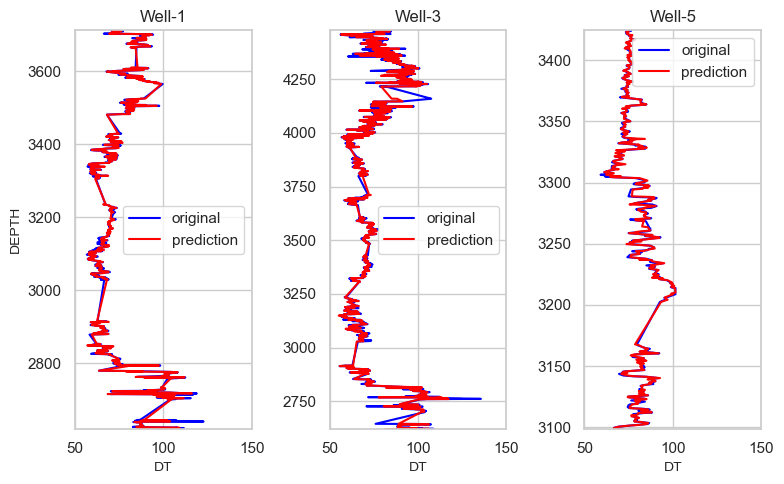

In [111]:
import matplotlib.pyplot as plt
import numpy as np
# Assuming you have data for well_1 and well_3
x = [well_1, well_3, well_5]
y = [well_1, well_3, well_5]
color = ['blue', 'red', 'blue', 'red', 'blue', 'red']
title = ['Well-1', 'Well-3', 'Well-5']

scale=1
# Create a 1x4 grid of subplots
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(8, 5))
              
for i in range(len(x)):   
    ax[i].plot(x[i]['True DT'].iloc[::scale*2].sort_index(), x[i]['True DT'].iloc[::scale*2].sort_index().index, color="blue")
    ax[i].plot(x[i]['Predicted_DT'][::scale*2] , x[i]['Predicted_DT'].iloc[::scale*2].index, color="red")

    ax[i].set_xlabel("DT", fontsize = 10)
    ax[0].set_ylabel("DEPTH", fontsize=10)
    ax[i].set_xlim(50, 150) 
    ax[i].set_title(title[i])

    ax[i].set_ylim(np.max(y[i].index), np.min(y[i].index))
               
    ax[i].legend(['original', 'prediction'])
    
    ax[i].invert_yaxis()

    #ax[i].invert_xaxis()
    #ax[i].invert_yaxis()
               
# Adjust the space between subplots
plt.tight_layout()

# Show the plot
plt.show()

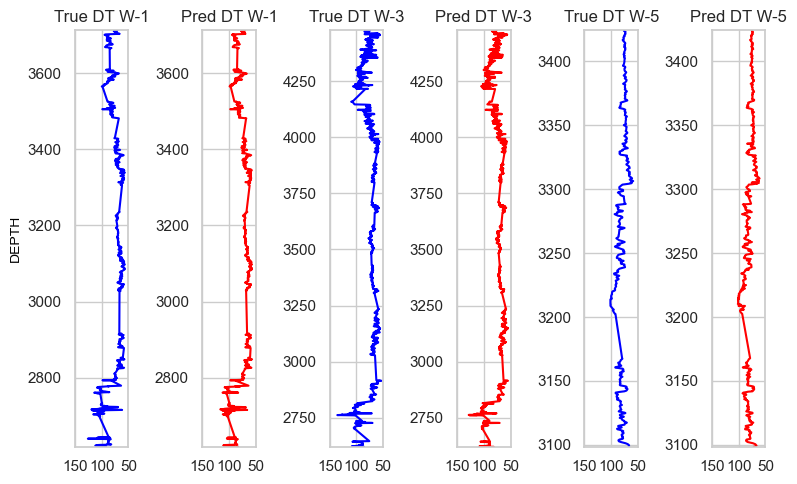

In [108]:
import matplotlib.pyplot as plt
import numpy as np

# Assuming you have data for well_1 and well_3
x = [well_1['True DT'], well_1['Predicted_DT'], well_3['True DT'], well_3['Predicted_DT'],well_5['True DT'],well_5['Predicted_DT']]
y = [well_1.index, well_1.index , well_3.index, well_3.index, well_5.index, well_5.index]
color = ['blue', 'red', 'blue', 'red', 'blue', 'red']
title = ['True DT W-1', 'Pred DT W-1', 'True DT W-3', 'Pred DT W-3', 'True DT W-5', 'Pred DT W-5']

# Create a 1x4 grid of subplots
fig, ax = plt.subplots(nrows=1, ncols=6, figsize=(8, 5))

for i in range(len(x)):
    ax[i].plot(x[i], y[i], color=color[i])
    ax[i].set_xlim(50, 150)
    ax[i].set_ylim(np.max(y[i]), np.min(y[i]))  # Reverse the y-axis for depth
    ax[i].set_title(title[i])
    ax[0].set_ylabel("DEPTH", fontsize = 10, color="black")
    ax[i].invert_xaxis()
    ax[i].invert_yaxis()

# Adjust the space between subplots
plt.tight_layout()

# Show the plot
plt.show()

### Prediction of DT for wells 2 and 6

In [104]:
# Repeat the same process for well2_main, well3_main, well4_main, and well5_main
well_2_main = pd.concat([well2_drill, (well2_log.sort_values(by='DEPTH')).reset_index(drop=True)], axis=1).drop("DEPT", axis=1)
well_3_main = pd.concat([well3_drill, (well3_log.sort_values(by='DEPTH')).reset_index(drop=True)], axis=1).drop("DEPT", axis=1)
well_4_main = pd.concat([well4_drill, (well4_log.sort_values(by='DEPTH')).reset_index(drop=True)], axis=1).drop("DEPT", axis=1)
well_5_main = pd.concat([well5_drill, (well5_log.sort_values(by='DEPTH')).reset_index(drop=True)], axis=1).drop("DEPT", axis=1)
well_6_main = pd.concat([well6_drill, (well6_log.sort_values(by='DEPTH')).reset_index(drop=True)], axis=1).drop("DEPT", axis=1)

In [105]:
well_2_main_depth_well = well_2_main[['DEPTH','WELL']]
well_6_main_depth_well = well_6_main[['DEPTH','WELL']]

well_2_main_selected = well_2_main[selected_feature_names]
well_6_main_selected = well_6_main[selected_feature_names]

well_2_main_selected = well_2_main_selected.fillna(well_2_main_selected.median())
well_6_main_selected = well_6_main_selected.fillna(well_2_main_selected.median())

well_2_main_selected = scaler.fit_transform(well_2_main_selected)
well_6_main_selected = scaler.fit_transform(well_6_main_selected)

y_pred2 = best_svr_model.predict(well_2_main_selected)
y_pred6 = best_svr_model.predict(well_6_main_selected)

well_2_main['DT']=y_pred2
well_6_main['DT']=y_pred6

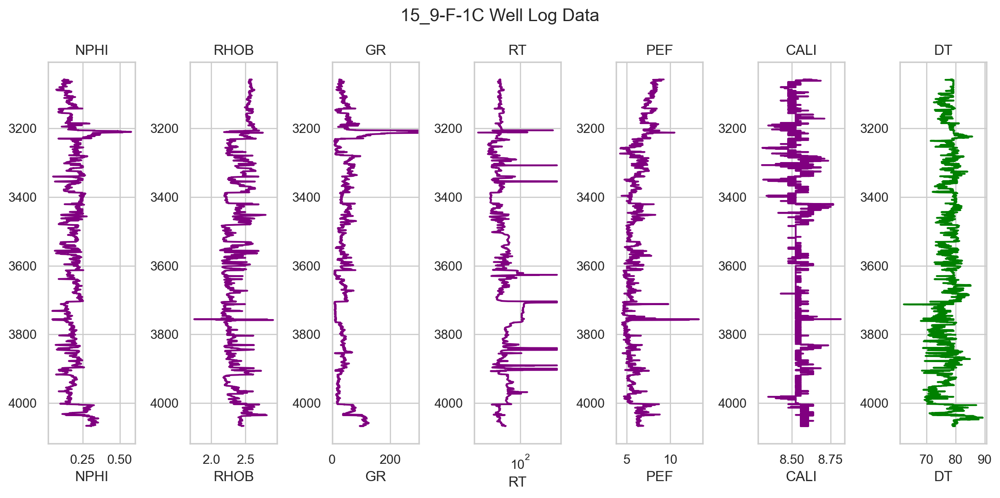

In [106]:
plot_well_logs(well_6_main,dataset_form='predicted')

<a id='conclusions'></a>
## Conclusions